In [1]:
import pandas as pd
import numpy as np

In [2]:
import warnings
warnings.filterwarnings(action='ignore')

In [19]:
import matplotlib.pyplot as plt
%matplotlib inline 
import platform #운영 체제 
from matplotlib import font_manager, rc
plt.rcParams['axes.unicode_minus'] = False 

if platform.system() == 'Darwin':
    rc('font', family = 'AppleGothic')
    
elif platform.system() == 'Windows':
    path="c:/Windows/Fonts/malgun.ttf"
    font_name = font_manager.FontProperties(fname=path).get_name()
    rc('font', family=font_name)
    
else:
    print('Unknown system')
    
plt.style.use('ggplot')
    
plt.rcParams['axes.unicode_minus'] = False #graph에서 마이너스 방지

In [5]:
import seaborn as sns

In [6]:
style=plt.style.available
style

['bmh',
 'classic',
 'dark_background',
 'fast',
 'fivethirtyeight',
 'ggplot',
 'grayscale',
 'seaborn-bright',
 'seaborn-colorblind',
 'seaborn-dark-palette',
 'seaborn-dark',
 'seaborn-darkgrid',
 'seaborn-deep',
 'seaborn-muted',
 'seaborn-notebook',
 'seaborn-paper',
 'seaborn-pastel',
 'seaborn-poster',
 'seaborn-talk',
 'seaborn-ticks',
 'seaborn-white',
 'seaborn-whitegrid',
 'seaborn',
 'Solarize_Light2',
 'tableau-colorblind10',
 '_classic_test']

In [7]:
plt.style.use(style[-4])

# 데이터 불러오기

In [8]:
clima=pd.read_csv('../data/adjusted_climate.csv')
clima

,year_local,area,year,평균기온 7월,평균기온 8월,평균기온 9월,평균기온 10월,평균기온 11월,평균기온 12월,평균기온 1월,...,순간최대풍속 9월,순간최대풍속 10월,순간최대풍속 11월,순간최대풍속 12월,순간최대풍속 1월,순간최대풍속 2월,순간최대풍속 3월,순간최대풍속 4월,순간최대풍속 5월,순간최대풍속 6월
0,1991_강원도,강원도,1991,22.827957,24.297133,18.242593,11.864875,7.723704,-1.206093,-4.854480,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1991_경기도,경기도,1991,25.051613,25.911828,20.493023,13.147312,8.160000,-0.915054,-4.255914,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,1991_경상남도,경상남도,1991,26.101075,27.240502,21.902222,15.447670,11.091111,3.099642,1.022581,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,1991_경상북도,경상북도,1991,24.853666,26.011144,20.131818,13.698534,9.552424,1.166276,-1.537243,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,1991_광주광역시,광주광역시,1991,26.590323,27.625806,22.496667,15.925806,11.573333,3.732258,1.438710,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
459,2019_전라남도,전라남도,2019,26.406048,26.978455,21.398333,14.785887,9.688333,4.221023,1.875893,...,8.630000,9.811694,7.856667,10.423864,10.804018,10.716518,12.120982,9.909375,9.979435,8.046250
460,2019_전라북도,전라북도,2019,26.887500,27.388710,20.442917,12.579839,6.805000,1.428977,-0.809375,...,7.307500,7.349597,5.769583,6.481818,6.341964,6.934821,8.884375,7.380357,7.684274,6.426582
461,2019_제주도,제주도,2019,25.447312,28.087097,23.584444,17.760215,14.137778,9.384848,6.883333,...,9.993333,10.611828,8.973333,11.909091,11.352381,10.565476,11.692857,9.042857,8.007527,7.308889
462,2019_충청남도,충청남도,2019,24.305161,27.466452,20.138667,12.011613,7.014000,0.330909,-1.005714,...,6.473333,7.002581,5.654667,6.339091,6.110714,6.544286,8.260000,7.385000,7.576129,6.124000


In [9]:
unit=pd.read_csv('../data/onion_unit_output.csv',encoding='euc-kr')
unit

,year_local,area,year,10a당 생산량 (kg)
0,2000_부산광역시,부산광역시,2000,5264
1,2001_부산광역시,부산광역시,2001,6045
2,2002_부산광역시,부산광역시,2002,6150
3,2003_부산광역시,부산광역시,2003,5875
4,2004_부산광역시,부산광역시,2004,6533
...,...,...,...,...
295,2015_제주도,제주도,2015,6552
296,2016_제주도,제주도,2016,6458
297,2017_제주도,제주도,2017,6945
298,2018_제주도,제주도,2018,6740


# Plot

### unit - plot

In [10]:
unit_pivot = pd.pivot_table(unit, 
                            values='10a당 생산량 (kg)', 
                            index=['area'], 
                            aggfunc=np.mean, 
                            fill_value=0)
unit_pivot

,10a당 생산량 (kg)
area,
강원도,4986.75
경기도,4182.15
경상남도,6801.35
경상북도,6736.05
광주광역시,6041.60
대구광역시,6200.00
대전광역시,4519.50
부산광역시,6631.60
울산광역시,5197.70


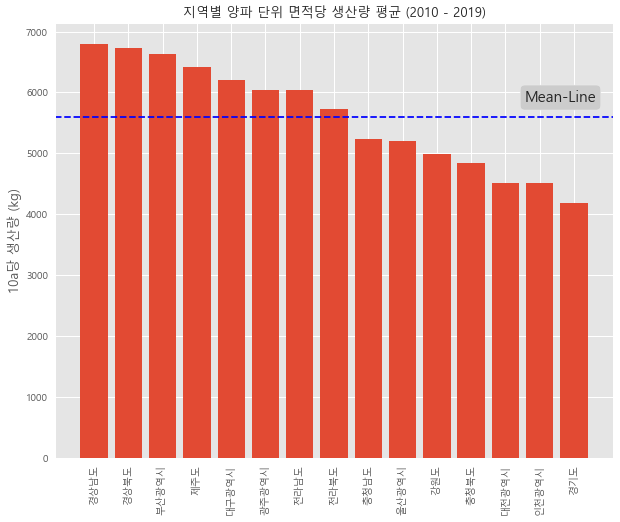

In [20]:
unit_sort = unit_pivot.sort_values(by='10a당 생산량 (kg)',
                                   ascending=False)
mean_data=np.mean(unit['10a당 생산량 (kg)'])

fig, ax = plt.subplots(figsize=(10, 8))
plt.xticks(rotation=90)

ax.bar(unit_sort.index,
       unit_sort['10a당 생산량 (kg)'],
       width=0.8)

ax.axhline(mean_data, ls='--', color='b') # 총 생산량 평균값 점선.

ax.set_ylabel('10a당 생산량 (kg)', fontsize=13)
ax.set_title('지역별 양파 단위 면적당 생산량 평균 (2010 - 2019)', fontsize=13)

xdata,ydata = 13, mean_data
bbox = dict(boxstyle="round", fc="0.8")
offset = 15

ax.annotate('Mean-Line',
            (xdata, ydata), 
            xytext=(-offset,offset), 
            textcoords='offset points',
            bbox=bbox,
            size=15)
plt.show()

## clima & unit join DataFrame

In [39]:
df=pd.merge(clima,
            unit,
            on=['year_local','area','year'])
df

,year_local,area,year,평균기온 7월,평균기온 8월,평균기온 9월,평균기온 10월,평균기온 11월,평균기온 12월,평균기온 1월,...,순간최대풍속 10월,순간최대풍속 11월,순간최대풍속 12월,순간최대풍속 1월,순간최대풍속 2월,순간최대풍속 3월,순간최대풍속 4월,순간최대풍속 5월,순간최대풍속 6월,10a당 생산량 (kg)
0,2000_강원도,강원도,2000,22.851613,22.855161,20.327333,11.978065,5.360333,-1.564839,-3.057097,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5297
1,2000_경기도,경기도,2000,24.954839,24.939785,22.005556,12.800000,6.118889,-1.186022,-2.425806,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2730
2,2000_경상남도,경상남도,2000,23.370609,24.310394,22.601481,14.784946,8.876296,2.881004,1.725806,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5264
3,2000_경상북도,경상북도,2000,22.916716,23.671261,21.520303,13.446041,7.355152,1.108798,-0.075367,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5592
4,2000_광주광역시,광주광역시,2000,24.993548,25.719355,23.753333,15.364516,9.646667,3.125806,0.983871,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,2019_전라남도,전라남도,2019,26.406048,26.978455,21.398333,14.785887,9.688333,4.221023,1.875893,...,9.811694,7.856667,10.423864,10.804018,10.716518,12.120982,9.909375,9.979435,8.046250,6873
296,2019_전라북도,전라북도,2019,26.887500,27.388710,20.442917,12.579839,6.805000,1.428977,-0.809375,...,7.349597,5.769583,6.481818,6.341964,6.934821,8.884375,7.380357,7.684274,6.426582,7957
297,2019_제주도,제주도,2019,25.447312,28.087097,23.584444,17.760215,14.137778,9.384848,6.883333,...,10.611828,8.973333,11.909091,11.352381,10.565476,11.692857,9.042857,8.007527,7.308889,7875
298,2019_충청남도,충청남도,2019,24.305161,27.466452,20.138667,12.011613,7.014000,0.330909,-1.005714,...,7.002581,5.654667,6.339091,6.110714,6.544286,8.260000,7.385000,7.576129,6.124000,5500


In [51]:
df.columns[3:-1]

Index(['평균기온 7월', '평균기온 8월', '평균기온 9월', '평균기온 10월', '평균기온 11월', '평균기온 12월',
       '평균기온 1월', '평균기온 2월', '평균기온 3월', '평균기온 4월',
       ...
       '순간최대풍속 9월', '순간최대풍속 10월', '순간최대풍속 11월', '순간최대풍속 12월', '순간최대풍속 1월',
       '순간최대풍속 2월', '순간최대풍속 3월', '순간최대풍속 4월', '순간최대풍속 5월', '순간최대풍속 6월'],
      dtype='object', length=120)

In [41]:
df_pivot = pd.pivot_table(df,values='평균기온 1월' ,index=['year_local'], fill_value=0) 
df_pivot

,평균기온 1월
year_local,
2000_강원도,-3.057097
2000_경기도,-2.425806
2000_경상남도,1.725806
2000_경상북도,-0.075367
2000_광주광역시,0.983871
...,...
2019_전라남도,1.875893
2019_전라북도,-0.809375
2019_제주도,6.883333


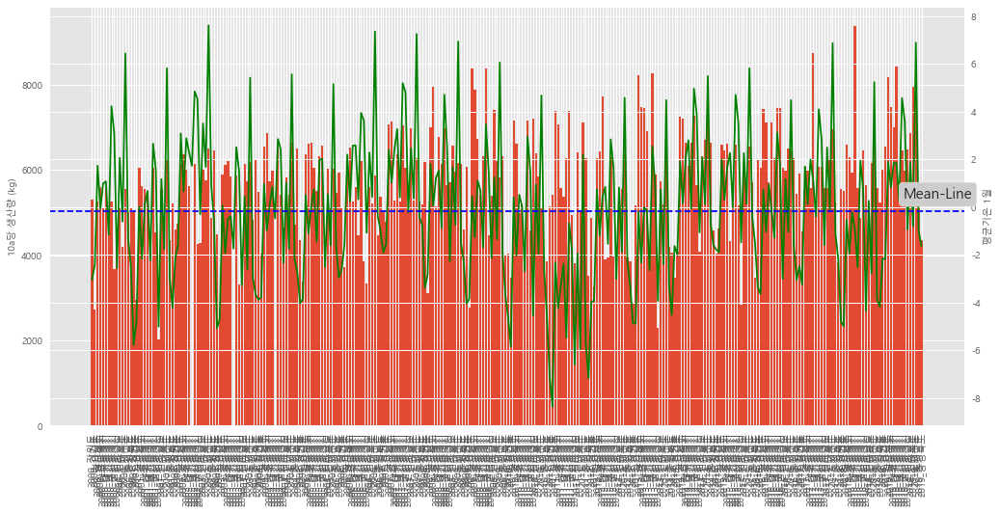

In [52]:
df_pivot2=pd.pivot_table(df,values='10a당 생산량 (kg)' ,index=['year_local'], fill_value=0)
mean_data=np.mean(df['평균기온 1월'])

fig, ax1 = plt.subplots(figsize=(17,8))

ax1.bar(df_pivot2.index,
        df_pivot2['10a당 생산량 (kg)'],
        width=0.8)
ax1.set_xticklabels(df_pivot2.index.values, rotation=90, fontsize = 10)
ax1.set_ylabel('10a당 생산량 (kg)',fontsize = 10)

ax2 = ax1.twinx()
ax2.plot(df_pivot.index,
         df_pivot['평균기온 1월'],
         color='g')
ax2.axhline(mean_data, ls='--', color='b') # 총 생산량 평균값 점선.

xdata, ydata = len(df_pivot2.index)-3, mean_data
bbox = dict(boxstyle="round", fc="0.8")
offset = 13
ax2.set_ylabel('평균기온 1월',fontsize = 10)
ax2.annotate('Mean-Line',
            (xdata, ydata), 
            xytext=(-offset,offset), 
            textcoords='offset points',
            bbox=bbox,
            size=15)
plt.show()

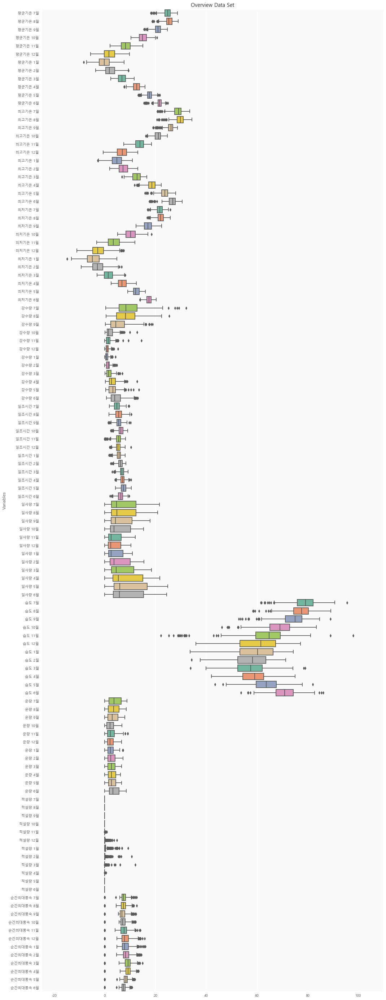

In [53]:
plt.style.use('ggplot') # Using ggplot2 style visuals 

f, ax = plt.subplots(figsize=(17, 50))

ax.set_facecolor('#fafafa')
ax.set(xlim=(-25, 110))
plt.ylabel('Variables')
plt.title("Overview Data Set")
ax = sns.boxplot(data = df[list(df.columns[3:-1])], 
                 orient = 'h', 
                 palette = 'Set2')

In [45]:
def temp_plot(temp):
    df_pivot = pd.pivot_table(df,values=temp ,index=['year_local'], fill_value=0) 
    df_pivot2=pd.pivot_table(df,values='10a당 생산량 (kg)' ,index=['year_local'], fill_value=0)
    mean_data=np.mean(df[temp])

    fig, ax1 = plt.subplots(figsize=(19,8))
    
    ax1.set_title(f'{temp} & 10a당 생산량 (kg)')
    ax1.bar(df_pivot2.index,
            df_pivot2['10a당 생산량 (kg)'],
            width=0.8)
    ax1.set_xticklabels(df_pivot2.index.values, rotation=90, fontsize = 10)
    ax1.set_ylabel('10a당 생산량 (kg)',fontsize = 20)

    ax2 = ax1.twinx()
    ax2.plot(df_pivot.index,
             df_pivot[temp],
             color='g')
    ax2.axhline(mean_data, ls='--', color='b') # 총 생산량 평균값 점선.

    xdata, ydata = len(df_pivot.index)-3, mean_data
    bbox = dict(boxstyle="round", fc="0.8")
    offset = 13
    ax2.set_ylabel(temp,fontsize = 20)
    ax2.annotate('Mean-Line',
                (xdata, ydata), 
                xytext=(-offset,offset), 
                textcoords='offset points',
                bbox=bbox,
                size=15)
    plt.show()

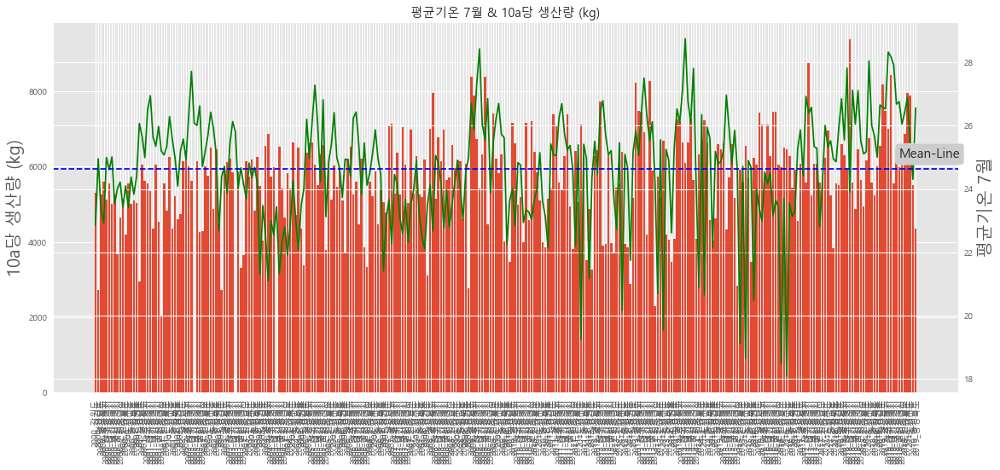

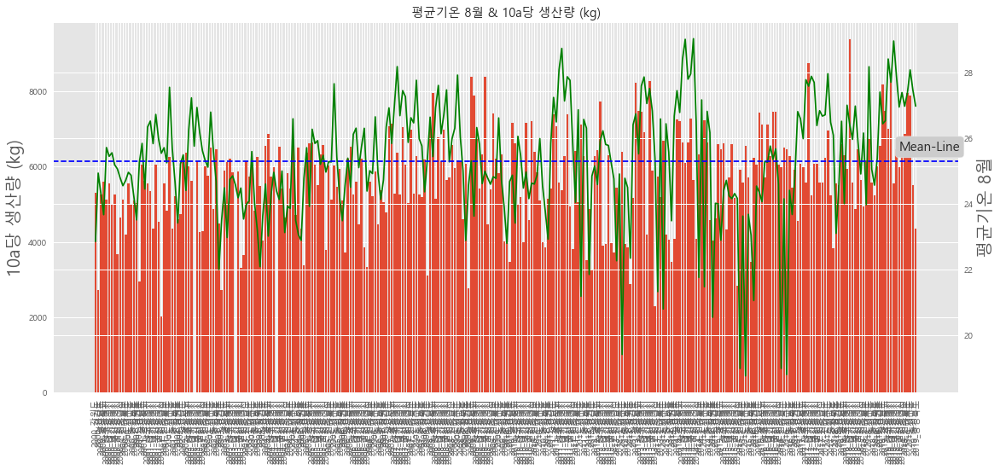

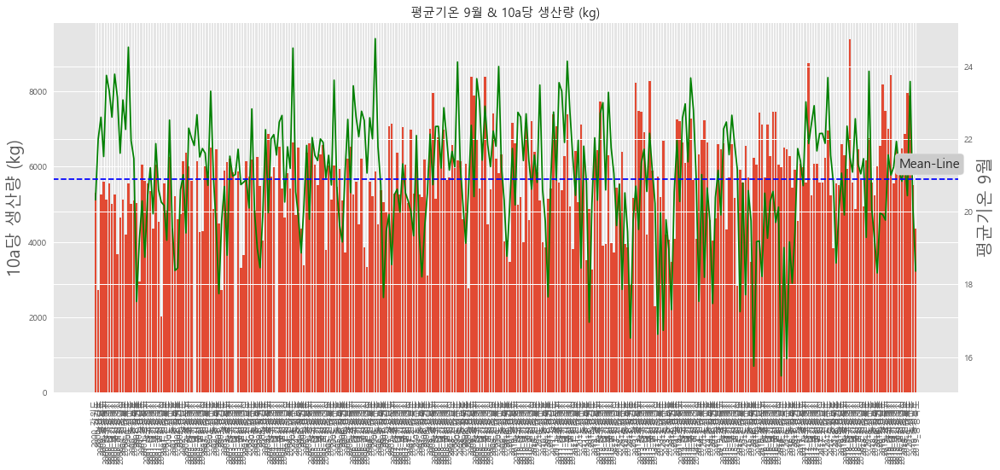

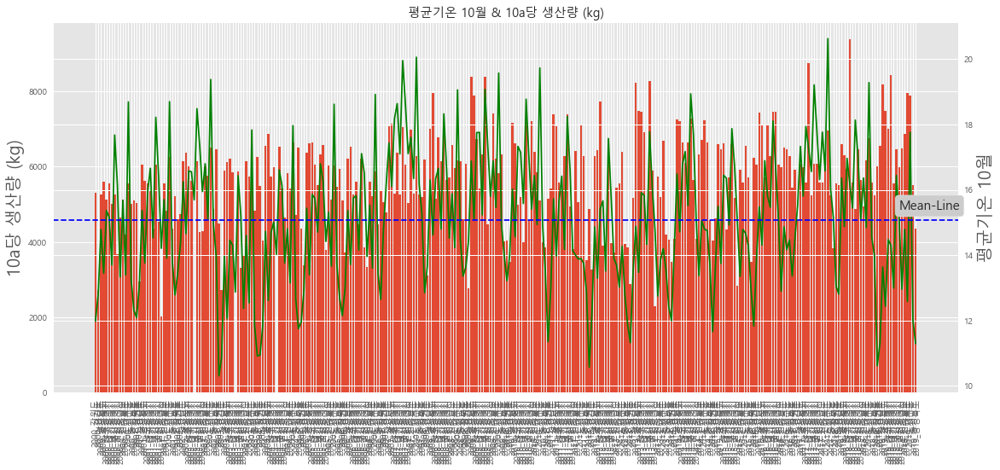

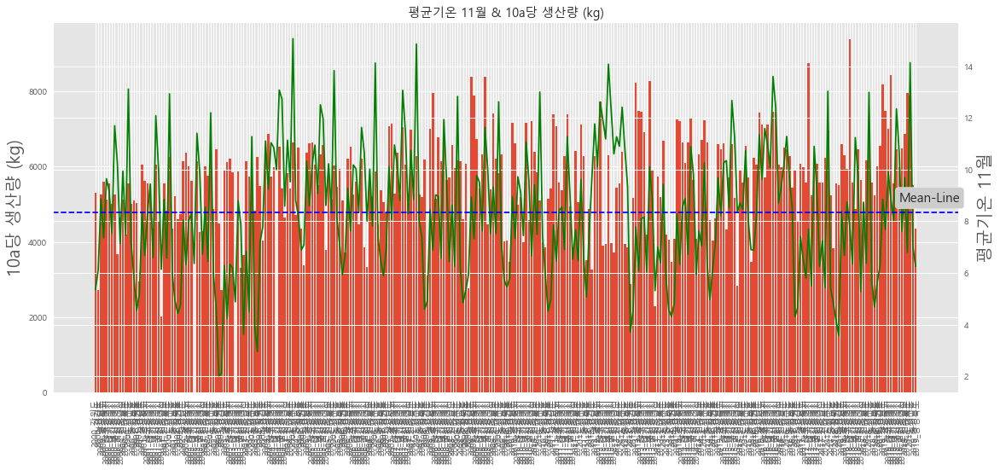

...

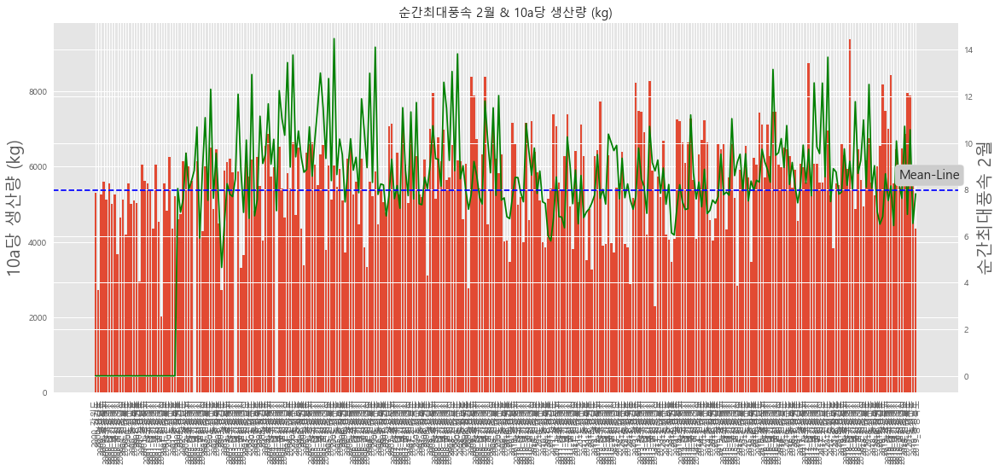

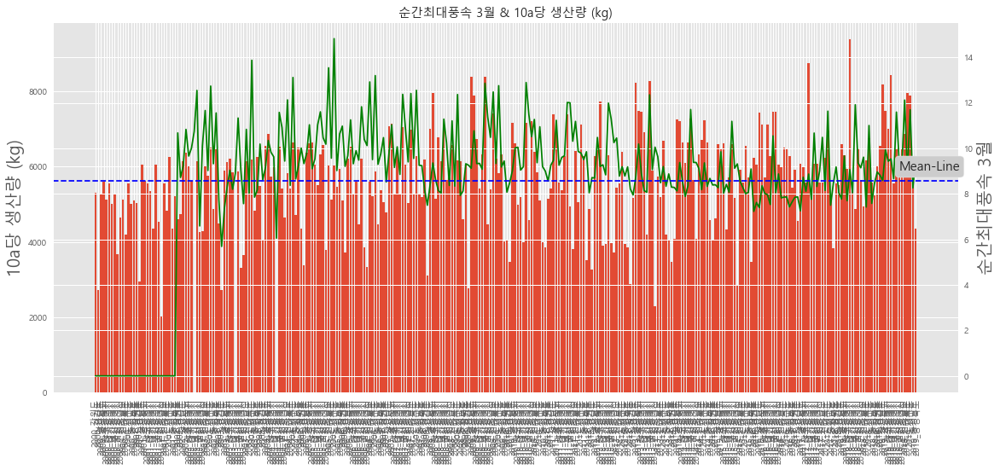

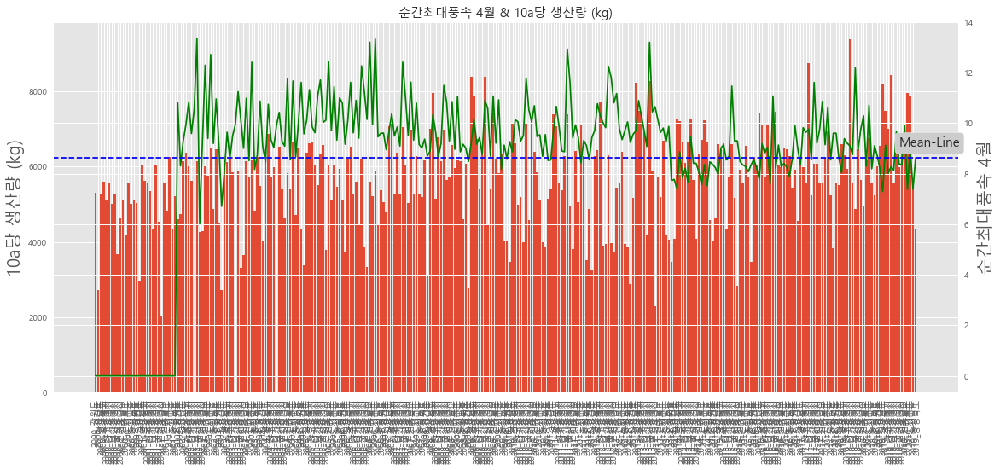

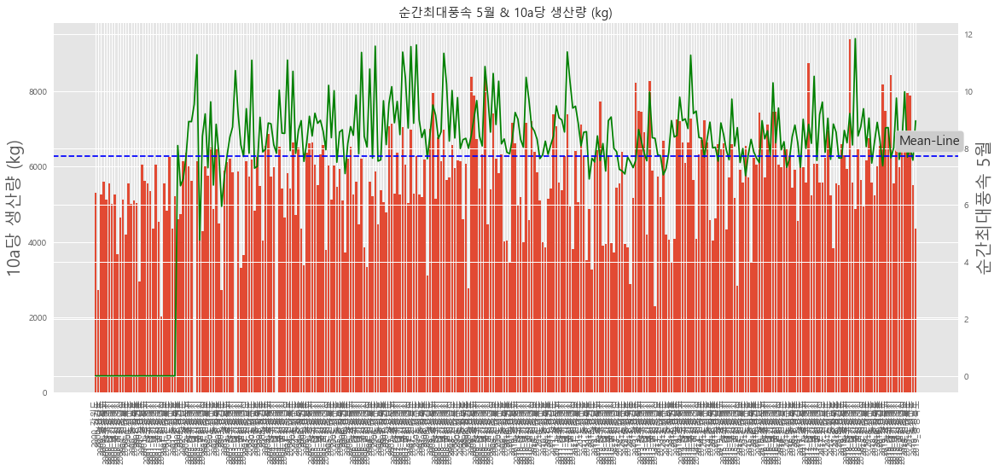

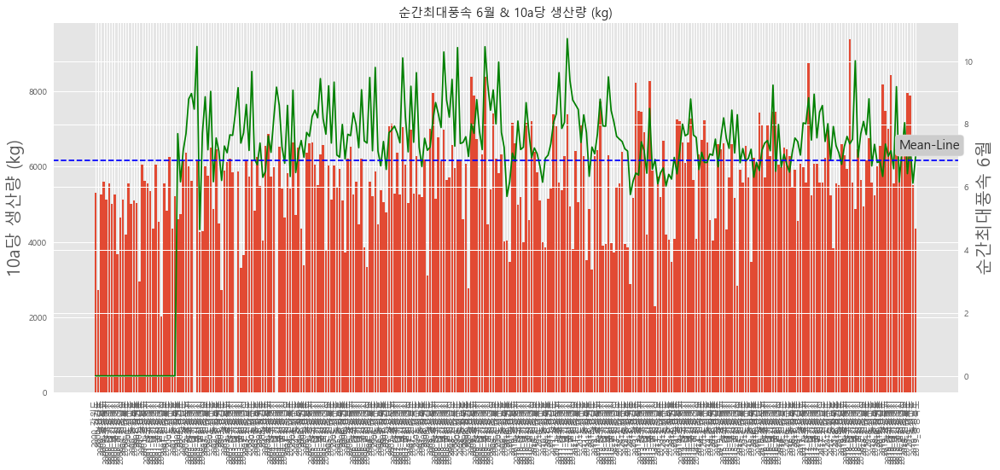

In [25]:
for col in df.columns[2:-3]:
    temp_plot(col)

## stepwise Regression

### 전진선택법(step=1)

In [26]:
def forward(X, y, predictors):
    # 데이터 변수들이 미리정의된 predictors에 있는지 없는지 확인 및 분류
    remaining_predictors = [p for p in X.columns.difference(['const']) if p not in predictors]
    tic = time.time()
    results = []
    for p in remaining_predictors:
        results.append(processSubset(X=X, y=y, feature_set=predictors+[p]+['const']))
        
    # 데이터프레임으로 변환
    models = pd.DataFrame(results)

    # AIC가 가장 낮은 것을 선택
    best_model = models.loc[models['AIC'].argmin()] # index
    toc = time.time()
    print("Processed ", models.shape[0], "models on", len(predictors)+1, "predictors in", (toc-tic))
    print('Selected predictors:',best_model['model'].model.exog_names,' AIC:',best_model[0] )
    return best_model

### 후진선택법(step=1)

In [27]:
import itertools

def backward(X,y,predictors):
    tic = time.time()
    results = []
    # 데이터 변수들이 미리정의된 predictors 조합 확인
    for combo in itertools.combinations(predictors, len(predictors) - 1):
        results.append(processSubset(X=X, y= y,feature_set=list(combo)+['const']))
    models = pd.DataFrame(results)
    # 가장 낮은 AIC를 가진 모델을 선택
    best_model = models.loc[models['AIC'].argmin()]
    toc = time.time()
    print("Processed ", models.shape[0], "models on", len(predictors) - 1, "predictors in",
          (toc - tic))
    print('Selected predictors:',best_model['model'].model.exog_names,' AIC:',best_model[0] )
    return best_model

In [28]:
def processSubset(X,y, feature_set):
            model = sm.OLS(y,X[list(feature_set)]) # Modeling
            regr = model.fit() # 모델 학습
            AIC = regr.aic # 모델의 AIC
            return {"model":regr, "AIC":AIC}

In [29]:
import time

def Stepwise_model(X,y):
    Stepmodels = pd.DataFrame(columns=["AIC", "model"])
    tic = time.time()
    predictors = []
    Smodel_before = processSubset(X,y,predictors+['const'])['AIC']
    # 변수 1~10개 : 0~9 -> 1~10
    for i in range(1, len(X.columns.difference(['const'])) + 1):
        Forward_result = forward(X=X, y=y, predictors=predictors) # constant added
        print('forward')
        Stepmodels.loc[i] = Forward_result
        predictors = Stepmodels.loc[i]["model"].model.exog_names
        predictors = [ k for k in predictors if k != 'const']
        Backward_result = backward(X=X, y=y, predictors=predictors)
        if Backward_result['AIC']< Forward_result['AIC']:
            Stepmodels.loc[i] = Backward_result
            predictors = Stepmodels.loc[i]["model"].model.exog_names
            Smodel_before = Stepmodels.loc[i]["AIC"]
            predictors = [ k for k in predictors if k != 'const']
            print('backward')
        if Stepmodels.loc[i]['AIC']> Smodel_before:
            break
        else:
            Smodel_before = Stepmodels.loc[i]["AIC"]
    toc = time.time()
    print("Total elapsed time:", (toc - tic), "seconds.")
    return (Stepmodels['model'][len(Stepmodels['model'])])

In [54]:
col_list = list(df.columns[3:-1])+['10a당 생산량 (kg)']
col_list

['평균기온 7월',
 '평균기온 8월',
 '평균기온 9월',
 '평균기온 10월',
 '평균기온 11월',
 '평균기온 12월',
 '평균기온 1월',
 '평균기온 2월',
 '평균기온 3월',
 '평균기온 4월',
 '평균기온 5월',
 '평균기온 6월',
 '최고기온 7월',
 '최고기온 8월',
 '최고기온 9월',
 '최고기온 10월',
 '최고기온 11월',
 '최고기온 12월',
 '최고기온 1월',
 '최고기온 2월',
 '최고기온 3월',
 '최고기온 4월',
 '최고기온 5월',
 '최고기온 6월',
 '최저기온 7월',
 '최저기온 8월',
 '최저기온 9월',
 '최저기온 10월',
 '최저기온 11월',
 '최저기온 12월',
 '최저기온 1월',
 '최저기온 2월',
 '최저기온 3월',
 '최저기온 4월',
 '최저기온 5월',
 '최저기온 6월',
 '강수량 7월',
 '강수량 8월',
 '강수량 9월',
 '강수량 10월',
 '강수량 11월',
 '강수량 12월',
 '강수량 1월',
 '강수량 2월',
 '강수량 3월',
 '강수량 4월',
 '강수량 5월',
 '강수량 6월',
 '일조시간 7월',
 '일조시간 8월',
 '일조시간 9월',
 '일조시간 10월',
 '일조시간 11월',
 '일조시간 12월',
 '일조시간 1월',
 '일조시간 2월',
 '일조시간 3월',
 '일조시간 4월',
 '일조시간 5월',
 '일조시간 6월',
 '일사량 7월',
 '일사량 8월',
 '일사량 9월',
 '일사량 10월',
 '일사량 11월',
 '일사량 12월',
 '일사량 1월',
 '일사량 2월',
 '일사량 3월',
 '일사량 4월',
 '일사량 5월',
 '일사량 6월',
 '습도 7월',
 '습도 8월',
 '습도 9월',
 '습도 10월',
 '습도 11월',
 '습도 12월',
 '습도 1월',
 '습도 2월',
 '습도 3월',
 '습도 4월',
 '습도 5월',
 '습도 6월',
 '운량 7월',
 '운량 8월',

In [55]:
df_area=pd.pivot_table(df,
                       values=col_list,
                       index=['area'],
                       aggfunc=np.mean,
                       fill_value=0)
df_area

,10a당 생산량 (kg),강수량 10월,강수량 11월,강수량 12월,강수량 1월,강수량 2월,강수량 3월,강수량 4월,강수량 5월,강수량 6월,...,평균기온 12월,평균기온 1월,평균기온 2월,평균기온 3월,평균기온 4월,평균기온 5월,평균기온 6월,평균기온 7월,평균기온 8월,평균기온 9월
area,,,,,,,,,,,,,,,,,,,,,
강원도,4986.75,2.066059,1.640110,0.763318,0.764253,1.074517,1.419762,2.573080,2.524670,4.046948,...,-1.607347,-3.640644,-0.941314,4.381863,10.544284,15.965713,19.813955,22.814522,23.030032,18.183745
경기도,4182.15,1.749767,1.497411,0.730162,0.565183,0.993749,1.148362,2.570342,2.861882,4.148044,...,-1.614053,-3.601600,-0.528320,5.135573,11.692263,17.538581,21.915722,24.774258,25.200516,20.305056
경상남도,6801.35,2.577997,1.547722,0.904084,0.735856,1.716156,2.464334,4.382209,4.434588,5.623389,...,2.914970,0.969986,3.221934,7.781453,13.153275,18.090860,21.808611,25.094982,25.707885,21.378888
경상북도,6736.05,2.123367,1.584413,1.052931,1.030691,1.245833,1.674897,2.908377,2.743260,4.028967,...,0.945290,-0.851962,1.448094,6.353318,12.267863,17.472826,21.231342,24.290420,24.610207,19.909005
광주광역시,6041.60,2.114384,1.804333,1.251430,1.009931,1.637549,1.811762,3.010571,2.979194,4.814500,...,3.011554,0.831048,2.931158,7.567486,13.534012,18.916129,22.890667,25.965645,26.450484,22.232667
대구광역시,6200.00,1.729107,0.943000,0.616913,0.500835,0.904489,1.494045,2.351714,2.527581,3.897167,...,2.692361,0.925801,3.424440,8.534897,14.472679,19.836452,23.410667,26.157742,26.592097,21.981167
대전광역시,4519.50,2.000703,1.429833,1.017823,0.835276,1.282186,1.582619,2.849048,2.703710,5.066000,...,0.804406,-1.184003,1.373079,6.716834,13.051036,18.703226,22.871333,25.513871,25.988548,21.273500
부산광역시,6631.60,2.988134,1.982333,1.149619,0.902195,1.753233,2.897498,5.003940,4.985645,5.421000,...,5.505836,3.367408,5.350677,9.126570,13.771798,17.921129,21.124667,24.520323,26.177258,22.548667
울산광역시,5197.70,2.581630,2.046000,0.830154,0.961227,1.460998,2.091028,3.216083,3.330484,4.370000,...,4.202463,2.309142,4.302174,8.581329,13.790143,18.443065,21.705667,25.338548,26.016774,21.648500


In [56]:
df_area_corr=df_area.corr()
df_area_corr

,10a당 생산량 (kg),강수량 10월,강수량 11월,강수량 12월,강수량 1월,강수량 2월,강수량 3월,강수량 4월,강수량 5월,강수량 6월,...,평균기온 12월,평균기온 1월,평균기온 2월,평균기온 3월,평균기온 4월,평균기온 5월,평균기온 6월,평균기온 7월,평균기온 8월,평균기온 9월
10a당 생산량 (kg),1.000000,0.586052,0.268400,0.459189,0.451747,0.640997,0.730641,0.651451,0.570729,0.492714,...,0.688051,0.696274,0.692240,0.650179,0.488756,0.161200,-0.118898,0.060273,0.192318,0.409311
강수량 10월,0.586052,1.000000,0.832648,0.601797,0.729434,0.889792,0.923935,0.874916,0.856404,0.755871,...,0.833598,0.829668,0.819318,0.722946,0.419953,-0.100849,-0.426082,-0.176594,0.110323,0.444416
강수량 11월,0.268400,0.832648,1.000000,0.674764,0.819893,0.780129,0.649226,0.581771,0.614627,0.527965,...,0.644507,0.627236,0.586558,0.443905,0.133768,-0.319217,-0.532894,-0.298494,-0.060496,0.270457
강수량 12월,0.459189,0.601797,0.674764,1.000000,0.880332,0.787499,0.579078,0.484281,0.414204,0.647921,...,0.602204,0.579404,0.514534,0.366526,0.124358,-0.181525,-0.297950,-0.094141,0.048426,0.317218
강수량 1월,0.451747,0.729434,0.819893,0.880332,1.000000,0.797024,0.614196,0.442880,0.398876,0.587681,...,0.677070,0.670616,0.614410,0.482248,0.217386,-0.182720,-0.399970,-0.171817,-0.047490,0.239607
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
평균기온 5월,0.161200,-0.100849,-0.319217,-0.181525,-0.182720,-0.048751,0.025774,-0.031640,-0.129071,-0.039733,...,0.163844,0.187778,0.286931,0.502960,0.827001,1.000000,0.911165,0.948150,0.865426,0.610544
평균기온 6월,-0.118898,-0.426082,-0.532894,-0.297950,-0.399970,-0.328751,-0.319936,-0.305218,-0.388721,-0.274945,...,-0.191189,-0.175311,-0.082310,0.141097,0.544815,0.911165,1.000000,0.946902,0.781270,0.417249
평균기온 7월,0.060273,-0.176594,-0.298494,-0.094141,-0.171817,-0.068408,-0.079363,-0.110540,-0.186507,-0.088247,...,0.091725,0.105820,0.192380,0.388452,0.716289,0.948150,0.946902,1.000000,0.901634,0.622893
평균기온 8월,0.192318,0.110323,-0.060496,0.048426,-0.047490,0.155325,0.184809,0.178399,0.175465,0.110741,...,0.387909,0.393013,0.475472,0.629915,0.832675,0.865426,0.781270,0.901634,1.000000,0.882965


In [59]:
c_list=df.columns[3:-1]

c_list_1=[]
c_list_2=[]
c_list_3=[]
c_list_4=[]
c_list_5=[]
c_list_6=[]
c_list_7=[]
c_list_8=[]
c_list_9=[]
c_list_10=[]

for i,col in enumerate(c_list):
    if i<12:
        c_list_1.append(col)
    elif i<24:
        c_list_2.append(col)
    elif i<36:
        c_list_3.append(col)
    elif i<48:
        c_list_4.append(col)    
    elif i<60:
        c_list_5.append(col)
    elif i<72:
        c_list_6.append(col)
    elif i<84:
        c_list_7.append(col)
    elif i<96:
        c_list_8.append(col)
    elif i<108:
        c_list_9.append(col)
    elif i<120:
        c_list_10.append(col)

In [60]:
c_month_group=[c_list_1,c_list_2,c_list_3,c_list_4,c_list_5,
               c_list_6,c_list_7,c_list_8,c_list_9,c_list_10]
c_month_group

[['평균기온 7월',
  '평균기온 8월',
  '평균기온 9월',
  '평균기온 10월',
  '평균기온 11월',
  '평균기온 12월',
  '평균기온 1월',
  '평균기온 2월',
  '평균기온 3월',
  '평균기온 4월',
  '평균기온 5월',
  '평균기온 6월'],
 ['최고기온 7월',
  '최고기온 8월',
  '최고기온 9월',
  '최고기온 10월',
  '최고기온 11월',
  '최고기온 12월',
  '최고기온 1월',
  '최고기온 2월',
  '최고기온 3월',
  '최고기온 4월',
  '최고기온 5월',
  '최고기온 6월'],
 ['최저기온 7월',
  '최저기온 8월',
  '최저기온 9월',
  '최저기온 10월',
  '최저기온 11월',
  '최저기온 12월',
  '최저기온 1월',
  '최저기온 2월',
  '최저기온 3월',
  '최저기온 4월',
  '최저기온 5월',
  '최저기온 6월'],
 ['강수량 7월',
  '강수량 8월',
  '강수량 9월',
  '강수량 10월',
  '강수량 11월',
  '강수량 12월',
  '강수량 1월',
  '강수량 2월',
  '강수량 3월',
  '강수량 4월',
  '강수량 5월',
  '강수량 6월'],
 ['일조시간 7월',
  '일조시간 8월',
  '일조시간 9월',
  '일조시간 10월',
  '일조시간 11월',
  '일조시간 12월',
  '일조시간 1월',
  '일조시간 2월',
  '일조시간 3월',
  '일조시간 4월',
  '일조시간 5월',
  '일조시간 6월'],
 ['일사량 7월',
  '일사량 8월',
  '일사량 9월',
  '일사량 10월',
  '일사량 11월',
  '일사량 12월',
  '일사량 1월',
  '일사량 2월',
  '일사량 3월',
  '일사량 4월',
  '일사량 5월',
  '일사량 6월'],
 ['습도 7월',
  '습도 8월',
  '습도 9월',
  '습도 10월',
  '습도 11월',
  '습도 1

In [61]:
import statsmodels.api as sm

In [62]:
def regression(c_list):
    X = df_area[c_list]
    y = df_area['10a당 생산량 (kg)']

    X = sm.add_constant(X)
    area_clima = sm.OLS(y, X).fit()
    return area_clima.summary()

In [63]:
for i, col in enumerate(c_month_group):
    print(f'\n{i+1}월 자료\n')
    print(regression(col))


1월 자료

                            OLS Regression Results                            
Dep. Variable:          10a당 생산량 (kg)   R-squared:                       0.971
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     5.531
Date:                Fri, 06 Mar 2020   Prob (F-statistic):              0.163
Time:                        16:56:39   Log-Likelihood:                -95.980
No. Observations:                  15   AIC:                             218.0
Df Residuals:                       2   BIC:                             227.2
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.307e+04   1.23e+04      3.496 

In [65]:
def stepwise(c_list):
    X = df_area[c_list]
    y = df_area['10a당 생산량 (kg)']

    X = sm.add_constant(X)
    Stepwise_best_model=Stepwise_model(X,y)
    return Stepwise_best_model.summary()

In [66]:
for i, col in enumerate(c_month_group):
    print(f'\n{i+1}월 자료\n')
    print(stepwise(col))


1월 자료

Processed  12 models on 1 predictors in 0.017953157424926758
Selected predictors: ['평균기온 1월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D568C8>
forward
Processed  1 models on 0 predictors in 0.0009980201721191406
Selected predictors: ['const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D34688>
Processed  11 models on 2 predictors in 0.010971307754516602
Selected predictors: ['평균기온 1월', '평균기온 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7720588>
forward
Processed  2 models on 1 predictors in 0.003000020980834961
Selected predictors: ['평균기온 1월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73476C8>
backward
Processed  11 models on 2 predictors in 0.008971691131591797
Selected predictors: ['평균기온 1월', '평균기온 11월', 'const']  AIC: <statsmodels.regression.linear_model.Regre

Processed  2 models on 1 predictors in 0.002992391586303711
Selected predictors: ['최고기온 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7339D08>
backward
Processed  11 models on 2 predictors in 0.013916254043579102
Selected predictors: ['최고기온 12월', '최고기온 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B734B308>
forward
Processed  2 models on 1 predictors in 0.0019958019256591797
Selected predictors: ['최고기온 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73BE488>
backward
Processed  11 models on 2 predictors in 0.012995719909667969
Selected predictors: ['최고기온 12월', '최고기온 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7335948>
forward
Processed  2 models on 1 predictors in 0.0029990673065185547
Selected predictors: ['최고기온 12월', 'const']  AIC: <statsmodels.regression.l

Processed  11 models on 2 predictors in 0.013935327529907227
Selected predictors: ['강수량 3월', '강수량 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7335EC8>
forward
Processed  2 models on 1 predictors in 0.0029859542846679688
Selected predictors: ['강수량 3월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7335B08>
Processed  10 models on 3 predictors in 0.011923074722290039
Selected predictors: ['강수량 3월', '강수량 7월', '강수량 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B0A08>
forward
Processed  3 models on 2 predictors in 0.003992319107055664
Selected predictors: ['강수량 7월', '강수량 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73C7E08>
backward
Processed  10 models on 3 predictors in 0.007970333099365234
Selected predictors: ['강수량 7월', '강수량 4월', '강수량 10월', 'const']  AIC: <statsm

Processed  9 models on 4 predictors in 0.016979217529296875
Selected predictors: ['일조시간 7월', '일조시간 6월', '일조시간 8월', '일조시간 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B731AE88>
forward
Processed  4 models on 3 predictors in 0.0059697628021240234
Selected predictors: ['일조시간 7월', '일조시간 6월', '일조시간 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73C7E08>
backward
Processed  9 models on 4 predictors in 0.0
Selected predictors: ['일조시간 7월', '일조시간 6월', '일조시간 8월', '일조시간 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73BE148>
forward
Processed  4 models on 3 predictors in 0.018411636352539062
Selected predictors: ['일조시간 7월', '일조시간 6월', '일조시간 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73BEE88>
backward
Processed  9 models on 4 predictors in 0.009947538375854492
Selected pre

Processed  10 models on 3 predictors in 0.011931896209716797
Selected predictors: ['습도 10월', '습도 9월', '습도 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7392948>
forward
Processed  3 models on 2 predictors in 0.004988908767700195
Selected predictors: ['습도 10월', '습도 9월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D54F08>
backward
Processed  10 models on 3 predictors in 0.010968923568725586
Selected predictors: ['습도 10월', '습도 9월', '습도 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73926C8>
forward
Processed  3 models on 2 predictors in 0.003997087478637695
Selected predictors: ['습도 10월', '습도 9월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D6FEC8>
backward
Processed  10 models on 3 predictors in 0.010938405990600586
Selected predictors: ['습도 10월', '습도 9월', '습도 12월', 

backward
Processed  12 models on 1 predictors in 0.011967658996582031
Selected predictors: ['운량 6월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7742988>
forward
Processed  1 models on 0 predictors in 0.002032041549682617
Selected predictors: ['const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D6F788>
backward
Processed  12 models on 1 predictors in 0.012966156005859375
Selected predictors: ['운량 6월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7742D08>
forward
Processed  1 models on 0 predictors in 0.002032041549682617
Selected predictors: ['const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73BE288>
backward
Processed  12 models on 1 predictors in 0.012928485870361328
Selected predictors: ['운량 6월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x

Processed  10 models on 3 predictors in 0.01297307014465332
Selected predictors: ['순간최대풍속 1월', '순간최대풍속 11월', '순간최대풍속 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73234C8>
forward
Processed  3 models on 2 predictors in 0.005017518997192383
Selected predictors: ['순간최대풍속 1월', '순간최대풍속 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B0488>
Processed  9 models on 4 predictors in 0.007982015609741211
Selected predictors: ['순간최대풍속 1월', '순간최대풍속 11월', '순간최대풍속 7월', '순간최대풍속 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73236C8>
forward
Processed  4 models on 3 predictors in 0.004001617431640625
Selected predictors: ['순간최대풍속 1월', '순간최대풍속 11월', '순간최대풍속 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73C7508>
Processed  8 models on 5 predictors in 0.00796818733215332
Selected 

## 연도-지역별  regression

In [67]:
df_year=pd.pivot_table(df,
                       values=col_list,
                       index=['year'],
                       aggfunc=np.mean,
                       fill_value=0)
df_year

,10a당 생산량 (kg),강수량 10월,강수량 11월,강수량 12월,강수량 1월,강수량 2월,강수량 3월,강수량 4월,강수량 5월,강수량 6월,...,평균기온 12월,평균기온 1월,평균기온 2월,평균기온 3월,평균기온 4월,평균기온 5월,평균기온 6월,평균기온 7월,평균기온 8월,평균기온 9월
year,,,,,,,,,,,,,,,,,,,,,
2000,4873.600000,3.634943,0.767374,0.331408,1.192374,0.160979,0.852275,1.390527,1.926569,5.202705,...,1.993080,0.393428,0.067515,6.561560,11.804825,17.063412,21.597758,23.974671,24.726031,22.532357
2001,4912.600000,1.205607,1.688697,0.390079,1.828650,2.259017,0.465376,1.051262,1.245414,8.095558,...,2.578903,-1.131319,1.777685,6.195782,13.107703,18.421970,21.808980,25.598045,25.663043,19.999467
2002,5184.600000,3.142597,0.548785,1.140267,2.085141,0.354673,1.800619,5.157857,3.613391,2.338268,...,1.298551,1.925386,3.017622,8.358766,13.685203,17.067704,21.307836,25.707631,25.605056,21.186088
2003,4880.733333,2.196884,0.603980,1.501090,0.870815,1.757336,1.749861,6.475452,6.504133,6.807826,...,2.948141,-1.133886,3.034002,6.486043,12.822602,17.704184,20.994833,24.505275,24.019297,20.440943
2004,5356.466667,0.832445,2.205452,0.532586,0.458550,1.617727,1.249559,3.261409,4.334926,7.327561,...,2.511573,-0.297832,3.531634,6.817424,13.059505,17.433171,21.816478,22.524857,24.012889,21.302353
2005,5612.200000,0.265002,1.868889,0.974772,0.481344,1.314372,2.206932,2.459836,2.561583,4.926223,...,3.818755,-0.556172,-0.014495,5.156365,13.398370,17.169459,22.334835,25.239067,25.260123,21.113613
2006,5117.933333,0.940476,1.202634,0.687568,0.953356,1.217581,0.528548,3.586104,5.454030,5.391929,...,-1.578019,1.255760,1.660339,6.308249,11.570077,17.301949,21.301672,24.957191,25.175524,21.980675
2007,5869.533333,1.030532,1.591474,0.746567,0.424339,1.738471,3.378543,1.243710,3.536135,3.103282,...,2.776074,1.642504,4.762400,7.243259,11.832254,17.626283,21.646368,23.248987,26.598645,19.856935
2008,6001.000000,2.150460,0.392710,1.160021,1.371495,0.376147,1.602318,1.770871,3.537822,6.361549,...,3.395988,0.433630,0.198980,7.422496,13.273565,17.407287,20.460128,23.709537,26.218199,21.556941


In [68]:
def regression(c_list):
    X = df_year[c_list]
    y = df_year['10a당 생산량 (kg)']

    X = sm.add_constant(X)
    area_clima = sm.OLS(y, X).fit()
    return area_clima.summary()

In [69]:
c_month_group[0][0].split(' ')[0]

'평균기온'

In [70]:
for i, col in enumerate(c_month_group):
    print("\n{0} 자료\n".format(c_month_group[i][0].split(' ')[0]))
    print(regression(col))


평균기온 자료

                            OLS Regression Results                            
Dep. Variable:          10a당 생산량 (kg)   R-squared:                       0.626
Model:                            OLS   Adj. R-squared:                 -0.015
Method:                 Least Squares   F-statistic:                    0.9759
Date:                Fri, 06 Mar 2020   Prob (F-statistic):              0.538
Time:                        16:58:56   Log-Likelihood:                -143.62
No. Observations:                  20   AIC:                             313.2
Df Residuals:                       7   BIC:                             326.2
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       3413.3927   8708.133      0.39

In [71]:
def stepwise(c_list):
    X = df_year[c_list]
    y = df_year['10a당 생산량 (kg)']

    X = sm.add_constant(X)
    Stepwise_best_model=Stepwise_model(X,y)
    return Stepwise_best_model.summary()

In [72]:
for i, col in enumerate(c_month_group):
    print("\n{0} 자료\n".format(c_month_group[i][0].split(' ')[0]))
    print(stepwise(col))


평균기온 자료

Processed  12 models on 1 predictors in 0.01499795913696289
Selected predictors: ['평균기온 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73AFDC8>
forward
Processed  1 models on 0 predictors in 0.00202178955078125
Selected predictors: ['const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7392248>
Processed  11 models on 2 predictors in 0.011971712112426758
Selected predictors: ['평균기온 8월', '평균기온 9월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B2F08>
forward
Processed  2 models on 1 predictors in 0.0019958019256591797
Selected predictors: ['평균기온 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7742F08>
Processed  10 models on 3 predictors in 0.008976221084594727
Selected predictors: ['평균기온 8월', '평균기온 9월', '평균기온 3월', 'const']  AIC: <statsmodels.regression.linear_model.Regre

Processed  10 models on 3 predictors in 0.012964725494384766
Selected predictors: ['최고기온 8월', '최고기온 5월', '최고기온 3월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B2AC8>
forward
Processed  3 models on 2 predictors in 0.004022359848022461
Selected predictors: ['최고기온 8월', '최고기온 5월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7742A48>
backward
Processed  10 models on 3 predictors in 0.009973287582397461
Selected predictors: ['최고기온 8월', '최고기온 5월', '최고기온 3월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B2748>
forward
Processed  3 models on 2 predictors in 0.004987955093383789
Selected predictors: ['최고기온 8월', '최고기온 5월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B2BC8>
backward
Processed  10 models on 3 predictors in 0.007979154586791992
Selected predictors: ['최고기온 8월', '최고기

Processed  11 models on 2 predictors in 0.012984037399291992
Selected predictors: ['강수량 8월', '강수량 1월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7347508>
forward
Processed  2 models on 1 predictors in 0.003026247024536133
Selected predictors: ['강수량 8월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7742D08>
Processed  10 models on 3 predictors in 0.012958049774169922
Selected predictors: ['강수량 8월', '강수량 1월', '강수량 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B5C08>
forward
Processed  3 models on 2 predictors in 0.004976749420166016
Selected predictors: ['강수량 8월', '강수량 1월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B734ABC8>
Processed  9 models on 4 predictors in 0.008951902389526367
Selected predictors: ['강수량 8월', '강수량 1월', '강수량 7월', '강수량 3월', 'const']  AIC: <statsmod

Processed  6 models on 5 predictors in 0.00700831413269043
Selected predictors: ['일조시간 8월', '일조시간 12월', '일조시간 1월', '일조시간 3월', '일조시간 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73926C8>
backward
Processed  7 models on 6 predictors in 0.009963035583496094
Selected predictors: ['일조시간 8월', '일조시간 12월', '일조시간 1월', '일조시간 3월', '일조시간 7월', '일조시간 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7392B48>
forward
Processed  6 models on 5 predictors in 0.00899958610534668
Selected predictors: ['일조시간 8월', '일조시간 12월', '일조시간 1월', '일조시간 3월', '일조시간 7월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73AFC48>
backward
Processed  7 models on 6 predictors in 0.009980440139770508
Selected predictors: ['일조시간 8월', '일조시간 12월', '일조시간 1월', '일조시간 3월', '일조시간 7월', '일조시간 11월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper ob

Processed  5 models on 4 predictors in 0.0069942474365234375
Selected predictors: ['일사량 8월', '일사량 12월', '일사량 3월', '일사량 10월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7720348>
backward
Total elapsed time: 0.25432634353637695 seconds.
                            OLS Regression Results                            
Dep. Variable:          10a당 생산량 (kg)   R-squared:                       0.862
Model:                            OLS   Adj. R-squared:                  0.825
Method:                 Least Squares   F-statistic:                     23.35
Date:                Fri, 06 Mar 2020   Prob (F-statistic):           2.70e-06
Time:                        16:59:28   Log-Likelihood:                -133.67
No. Observations:                  20   AIC:                             277.3
Df Residuals:                      15   BIC:                             282.3
Df Model:                           4                                         

Processed  9 models on 4 predictors in 0.011003971099853516
Selected predictors: ['운량 9월', '운량 8월', '운량 12월', '운량 2월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B7390F88>
forward
Processed  4 models on 3 predictors in 0.008940458297729492
Selected predictors: ['운량 9월', '운량 8월', '운량 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B5208>
backward
Processed  9 models on 4 predictors in 0.01197052001953125
Selected predictors: ['운량 9월', '운량 8월', '운량 12월', '운량 2월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B5988>
forward
Processed  4 models on 3 predictors in 0.004980802536010742
Selected predictors: ['운량 9월', '운량 8월', '운량 12월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B51C8>
backward
Processed  9 models on 4 predictors in 0.009978771209716797
Selected predictors: 

Processed  10 models on 3 predictors in 0.011091947555541992
Selected predictors: ['적설량 11월', '적설량 4월', '적설량 10월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B73B2A08>
forward
Processed  3 models on 2 predictors in 0.0
Selected predictors: ['적설량 11월', '적설량 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6E81908>
backward
Processed  10 models on 3 predictors in 0.023691892623901367
Selected predictors: ['적설량 11월', '적설량 4월', '적설량 10월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6E81448>
forward
Processed  3 models on 2 predictors in 0.005986928939819336
Selected predictors: ['적설량 11월', '적설량 4월', 'const']  AIC: <statsmodels.regression.linear_model.RegressionResultsWrapper object at 0x00000203B6D58348>
backward
Processed  10 models on 3 predictors in 0.00797128677368164
Selected predictors: ['적설량 11월', '적설량 4월', '적설량 10월', 'cons